# ESA PolInSAR & BIOMASS 2023
# 7th Advanced Training Course on Radar Polarimetry
# 12-16 June 2023 - ISAE-SUPAERO, Toulouse, France 
# Part 2: The coherency matrix and the entropy/anisotropy/alpha decomposition

* Acquisition: San Francisco (USA), ALOS PALSAR, L-band

* Path to images: /projects/s3-drive/user-data/polinsar/data/

* SLC (single-look complex) real & imag parts files:
    * HH: i_HH.bin, q_HH.bin
    * HV: i_HV.bin, q_HV.bin
    * VH: i_VH.bin, q_VH.bin
    * VV: i_VV.bin, q_VV.bin
    
* Original Image size (px in azimuth x range): 18432 x 1248


Tips:
- focus on a azimuth block within pixels [7000, 12000].

In [2]:
%matplotlib widget
# import useful libraries, functions, and modules

import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage import uniform_filter

def HSV_colormap_to_rgb(colormap, h, s, v):
    """
    Makes an HSV-like RGB representation based on the given colormap instead
    of 'hsv' colormap.
    
    See https://en.wikipedia.org/wiki/HSL_and_HSV

    Parameters
    ----------
    colormap : function
        Colormap function. Takes the values in 'h' array and returns an RGBA
        value for each point. The ones in matplotlib.cm should be compatible
    h : ndarray
        Hue values. Usually between 0 and 1.0.
    s : ndarray
        Saturation values. Between 0 and 1.0.
    v : ndarray
        Value values. Between 0 and 1.0.

    Returns
    -------
    rgb: ndarray
        An array with the same shape as input + (3,) representing the RGB.
    """
    # Generate color between given colormap (colormap(h)) and white (ones)
    # according to the given saturation
    tmp = (1-s)[..., np.newaxis]*np.ones(3) + s[..., np.newaxis] * colormap(h)[...,:3]
    # Scale it by value
    return v[..., np.newaxis] * tmp


## Exercise 4: Target decomposition theomems. Eigenvalue/Eigenvector decomposition and  H/A/Alpha parameters

In this exersise you are going to compute the Eigenvalue/Eigenvectir decomposition and the associated H/A/Alpha parameters. This decomposition allows to characerize and to interpret the scattering mechanism present in the scene.

**Step 1: Load data**. In this step you have to load the data and select a section of the whole image compris ingthe azimuth between sampels 7000 to 12000.

In [3]:
# path to data
path = '/home/data/'


img_shape = (18432, 1248)

def read_slc(pol_name):
    slc = np.fromfile(path + 'i_%s.bin' % pol_name, dtype=np.float32) + 1j*np.fromfile(path + 'q_%s.bin' % pol_name, dtype=np.float32)
    return slc.reshape(img_shape) / 1e6

slchh = read_slc('HH')
slchv = read_slc('HV')
slcvh = read_slc('VH')
slcvv = read_slc('VV')

slchh.shape

(18432, 1248)

In [4]:
# Crop images in azimuth
crop_az = (7000, 12000)
slchh = slchh[crop_az[0]:crop_az[1], :]
slchv = slchv[crop_az[0]:crop_az[1], :]
slcvh = slcvh[crop_az[0]:crop_az[1], :]
slcvv = slcvv[crop_az[0]:crop_az[1], :]

slchh.shape

(5000, 1248)

**Step 2 : Calculate the coherency matrix**. In this step you have to copute the coherency matrix of the image, taking into accout that this matrix is derived through a speckle filtering process. Consider a standard Boxcar filter, where the filter dimension can not be equal to obtain a filtered image with a better aspect ratio.

Step 2.1 : Generate the Pauli vector

In [5]:
# --- calculate Pauli elements
pauli1 = (slchh + slcvv) / np.sqrt(2)
pauli2 = (slchh - slcvv) / np.sqrt(2)
pauli3 = (slchv + slcvh) / np.sqrt(2)

# Delete original SLCs to save memory
del slchh, slcvv, slchv, slcvh

In [6]:
# Join Pauli elements into Pauli scattering vector w_p
wp = np.dstack((pauli1, pauli2, pauli3))

# w_p is a 3 element vector for each pixel
wp.shape

(5000, 1248, 3)

Step 2.2 : Generate the T3 Coherency matrix

In [7]:
# Compute coherency matrix T3 as the outer product of w_p with w_p.conj()
T3 = np.einsum('...i,...j->...ij', wp, wp.conj())

# Delete wp to save memory
del wp

# T3 is a 3 by 3 matrix for each pixel
T3.shape

(5000, 1248, 3, 3)

Step 2.3 : Perform a Multilook over T3 to obtain Positive Definite matrices

In [8]:
# Number of pixels to average in azimuth and range for the Multilook
looksa = 9
looksr = 5

# Perform the multilook over the T3 matrix
T3 = uniform_filter(T3, (looksa, looksr, 1, 1))

T3.shape

(5000, 1248, 3, 3)

In [9]:
# Check that T3 matrix is Hermitian
np.set_printoptions(precision=3)
T3[0,0,:,:]

array([[1.083e-01+0.000e+00j, 6.745e-04-4.728e-04j, 2.536e-03+1.651e-03j],
       [6.745e-04+4.728e-04j, 2.312e-03+0.000e+00j, 9.946e-05-9.865e-05j],
       [2.536e-03-1.651e-03j, 9.946e-05+9.865e-05j, 4.099e-04+0.000e+00j]],
      dtype=complex64)

**Step 3: Calculate eigenvalues**. In this step you must derive the eigenvalues (3) associated to the eigenvalue/eigenvector decomposition of the coherency matrix.

Tips: Use [numpy.linalg.eigh](https://numpy.org/doc/stable/reference/generated/numpy.linalg.eigh.html) function to decompose hermitian matrices into eigenvalues and eigenvectors.

In [10]:
# Perform eigendecomposition of T3 (hermitian) matrix
W, V = np.linalg.eigh(T3)

# W contains the eigenvalues and V the eigenvectors
W.shape

(5000, 1248, 3)

In [11]:
# Note that np.linalg.eigh returns the eigenvalues & eigenvectors ordered in ascending order --> lambda_1 (larger) is the last one
lambda1 = W[:,:,2]
lambda2 = W[:,:,1]
lambda3 = W[:,:,0]

In [12]:
lambda1.shape

(5000, 1248)

**Step 4: Calculate Entropy**, In this step you must obtain the Entopy parameter (H) derived from the eigenvalues. Remember that the Entropy is derived from the associated probabilities of the eigenvalues and not form the eigenvalues directly.

In [13]:
# --- Compute probabilities

pr1 = lambda1 / (lambda1 + lambda2 + lambda3) 
pr2 = lambda2 / (lambda1 + lambda2 + lambda3)
pr3 = lambda3 / (lambda1 + lambda2 + lambda3)

# --- Compute entropy
entropy = - ( pr1*np.log10(pr1)/np.log10(3) + pr2*np.log10(pr2)/np.log10(3) + pr3*np.log10(pr3)/np.log10(3) )


**Step 5: Calculate Anisotropy**: In this step you must obtain the Anosotropy parameter (A) derived from the eigenvalues. 

In [14]:
anisotropy = (lambda2 - lambda3) / (lambda2 + lambda3)

**Step 6: Calculate eigenvectors**. In this step you must derive the eigenvectors (3) associated to the eigenvalue/eigenvector decomposition of the coherency matrix.

In [15]:
# Note that np.linalg.eigh returns the eigenvectors ordered in ascending order --> U1 corresponding to lambda_1 is the last one
U1 = V[:, :, :, 2]
U2 = V[:, :, :, 1]
U3 = V[:, :, :, 0]

In [16]:
U1.shape

(5000, 1248, 3)

**Step 7 : Calculate mean Alpha angle**In this step you must obtain the mean Alpha Angle parameter (Alpha) derived from the eigenvectors of the cogherency matrix. 

In [17]:
# extract alpha angles

alpha1 = np.arccos(np.abs(U1[:,:,0]))
alpha2 = np.arccos(np.abs(U2[:,:,0]))
alpha3 = np.arccos(np.abs(U3[:,:,0]))


In [18]:
# calculate the mean alpha angle
alpha = pr1*alpha1 + pr2*alpha2 + pr3*alpha3 # [rad]
alpha = alpha * 180/np.pi   # [deg]


**Step 8: Plot**. In this step you must plot the different results. To better interpret the eigendecomposition of the coherency matrix, as well as the different parameter derived from it, it is proposed to compute and plot firs the Pauli decomposiion. Them plot the probalilities, the paramenters H/A/Alpha and a HSV composition of H/Alpha.

In [19]:
# -- Generate Pauli RGB from coherency matrix diagonal elements
# NOTE: square root applied to convert intensities to amplitudes for visualization
# NOTE: the ordering of channels R, G, B --> Pauli 2, Pauli 3, Pauli 1
naz = pauli1.shape[0]
nrg = pauli1.shape[1]
pauli_rgb = np.zeros((nrg, naz, 3), 'float32')

T11 = T3[:, :, 0, 0]
T22 = T3[:, :, 1, 1]
T33 = T3[:, :, 2, 2]
pauli_rgb[:,:,0] = np.clip(np.transpose(np.sqrt(np.abs(T22))), 0, 2.5*np.mean(np.sqrt(np.abs(T22)))) 
pauli_rgb[:,:,1] = np.clip(np.transpose(np.sqrt(np.abs(T33))), 0, 2.5*np.mean(np.sqrt(np.abs(T33)))) 
pauli_rgb[:,:,2] = np.clip(np.transpose(np.sqrt(np.abs(T11))), 0, 2.5*np.mean(np.sqrt(np.abs(T11)))) 

pauli_rgb[:,:,0] = pauli_rgb[:,:,0] / np.max(pauli_rgb[:,:,0]) 
pauli_rgb[:,:,1] = pauli_rgb[:,:,1] / np.max(pauli_rgb[:,:,1]) 
pauli_rgb[:,:,2] = pauli_rgb[:,:,2] / np.max(pauli_rgb[:,:,2]) 



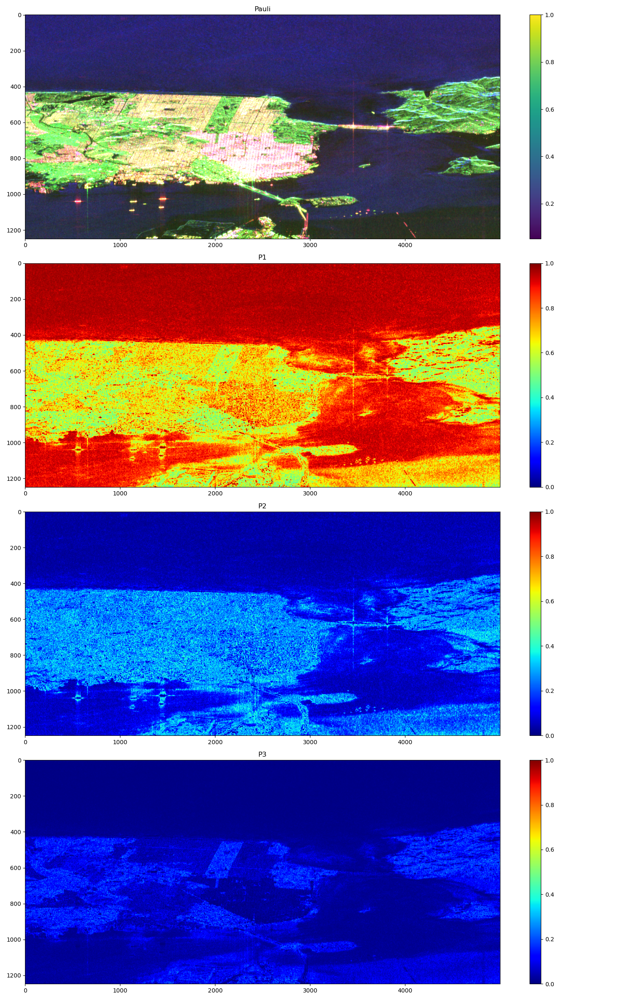

In [20]:
# -- plot Pauli RGB and probabilities

plt.figure(figsize = (15, 6*4))

ax = plt.subplot(4,1,1)
plt.imshow(pauli_rgb, aspect = 'auto')
plt.colorbar() # dummy colorbar to align images
ax.set_title("Pauli")

ax = plt.subplot(4,1,2)
plt.imshow(np.transpose(pr1) , vmin = 0 , vmax = 1, cmap = 'jet', aspect = 'auto', interpolation = 'nearest')
plt.colorbar()
ax.set_title("P1")

ax = plt.subplot(4,1,3)
plt.imshow(np.transpose(pr2) , vmin = 0 , vmax = 1, cmap = 'jet', aspect = 'auto', interpolation = 'nearest')
plt.colorbar()
ax.set_title("P2")

ax = plt.subplot(4,1,4)
plt.imshow(np.transpose(pr3) , vmin = 0 , vmax = 1, cmap = 'jet', aspect = 'auto', interpolation = 'nearest')
plt.colorbar()
ax.set_title("P3")

plt.tight_layout()


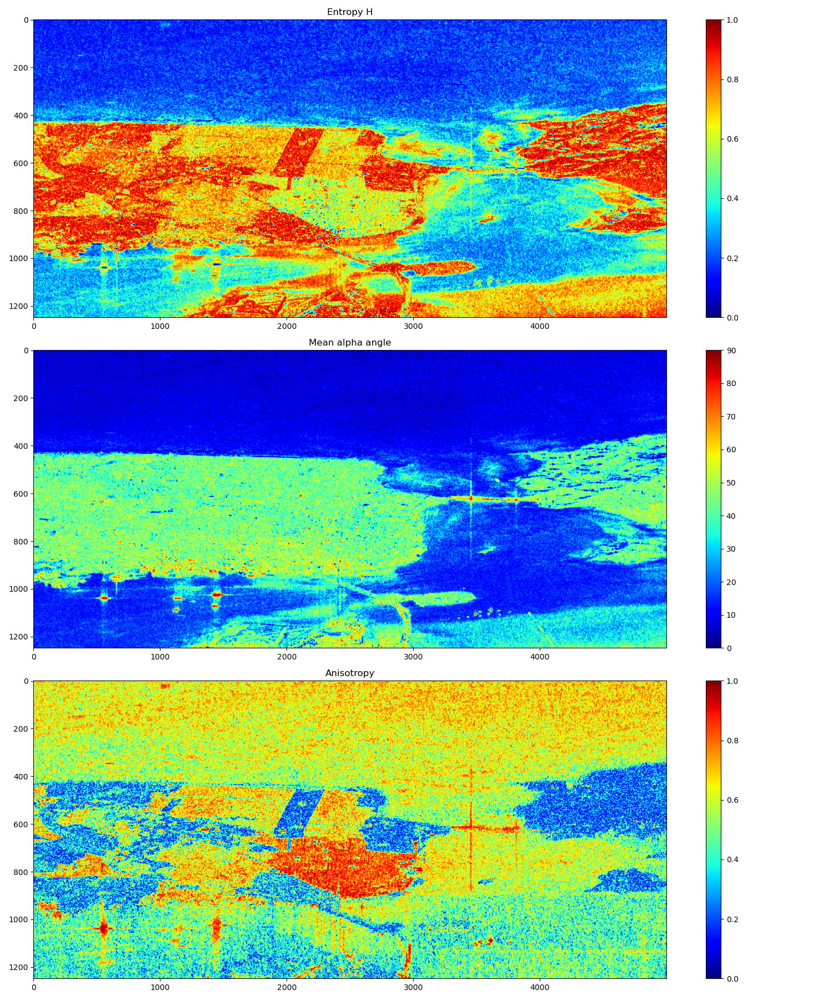

In [21]:
# Plot of entropy / mean alpha / anistropy

plt.figure(figsize = (15, 6*3))
ax = plt.subplot(3,1,1)
plt.imshow(np.transpose(entropy), vmin = 0, vmax = 1, cmap = 'jet', aspect = 'auto', interpolation = 'nearest')
plt.colorbar()
ax.set_title('Entropy H')

ax = plt.subplot(3,1,2)
plt.imshow(np.transpose(alpha), vmin = 0, vmax = 90, cmap = 'jet', aspect = 'auto', interpolation = 'nearest')
plt.colorbar()
ax.set_title('Mean alpha angle')

ax = plt.subplot(3,1,3)
plt.imshow(np.transpose(anisotropy), vmin = 0, vmax = 1, cmap = 'jet', aspect = 'auto', interpolation = 'nearest')
plt.colorbar()
ax.set_title('Anisotropy')

plt.tight_layout()

In [22]:
### HSV representation of H/alpha

colormap = plt.colormaps.get('jet')

# Normalize the alpha into 0 to 1
alpha = alpha / 90

# Intensity : amp
amp = np.sqrt(np.abs(T11) + np.abs(T22) + np.abs(T33))
amp = np.clip(amp, 0, 2.5*np.mean(amp))
amp = amp /np.max(amp)

# First case: take saturation = 1
saturation = np.ones_like(alpha)
rgb_alpha = HSV_colormap_to_rgb(colormap, alpha, saturation, amp)

# Second case: take saturation = 1 - entropy 
saturation = 1 - entropy
rgb_Halpha = HSV_colormap_to_rgb(colormap, alpha, saturation, amp)

In [23]:
del amp, saturation

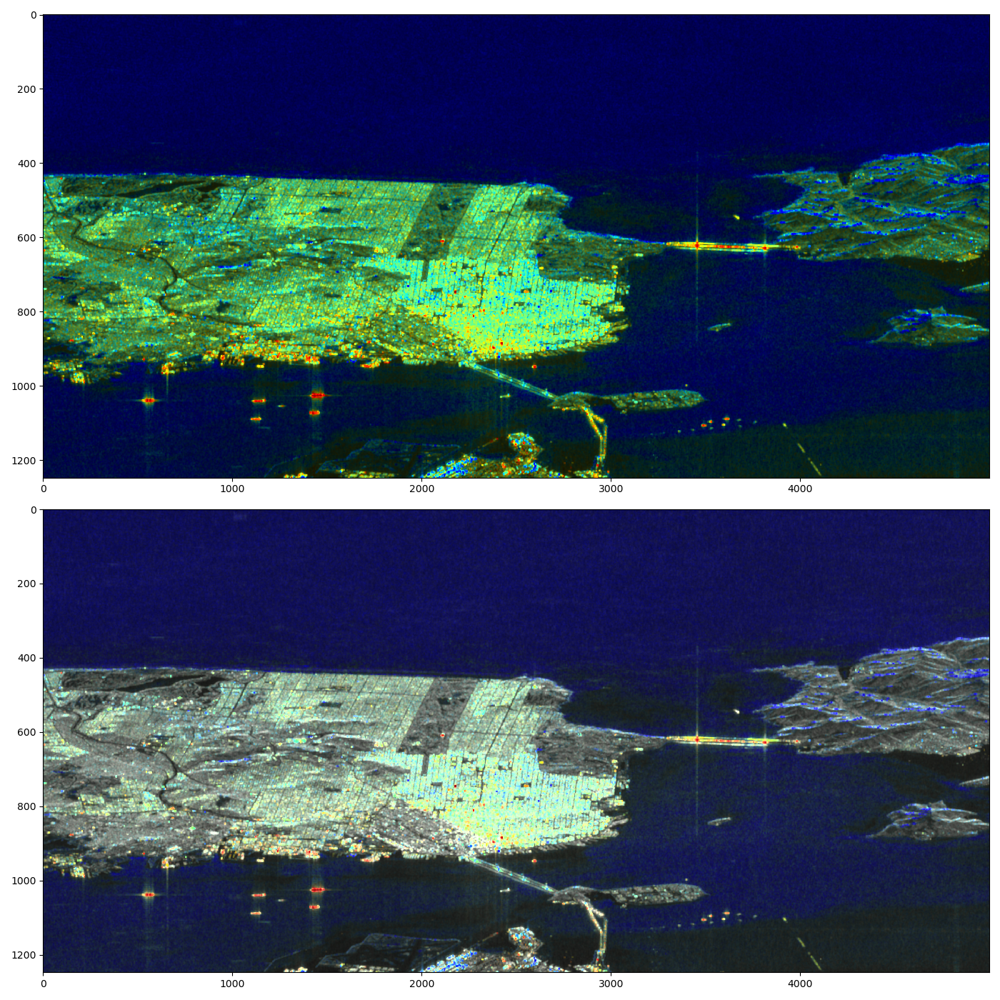

In [24]:
# Plots

plt.figure(figsize = (14, 14))
plt.subplot(2,1,1)
plt.imshow(np.transpose(rgb_alpha, axes = (1,0,2)), aspect = 'auto', interpolation = 'nearest')
plt.subplot(2,1,2)
plt.imshow(np.transpose(rgb_Halpha, axes = (1,0,2)), aspect = 'auto', interpolation = 'nearest')
plt.tight_layout()

